In [1]:
import numpy as np
from numpy import sort
np.set_printoptions(threshold=np.inf)
import pandas as pd
from scipy import stats
#sklearn
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import ensemble
from sklearn import datasets
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score
from sklearn.feature_selection import SelectFromModel
#xgboost
from xgboost import XGBClassifier
from xgboost import plot_importance
#matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
pd.options.display.float_format = '{:.3f}'.format
from matplotlib import pyplot
import seaborn as sns
#plotly
import plotly.plotly as py
from plotly.graph_objs import *
import plotly
import plotly.tools as tls
import plotly.graph_objs as go
import plotly.figure_factory as ff
from  plotly  import __version__
#plotly offline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
print(__version__) # requires version >= 1.9.0
init_notebook_mode(connected=True)
import warnings
warnings.filterwarnings("ignore") 

3.1.0


In [2]:
import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()

In [3]:
df = pd.read_csv('~/Desktop/python/gun_violence_data.csv')
pd.set_option('display.max_columns', 45)

In [4]:
df.head(2)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,incident_url_fields_missing,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,location_description,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_name,participant_relationship,participant_status,participant_type,sources,state_house_district,state_senate_district
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,False,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,NaN,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Julian Sims,NaN,0::Arrested||1::Injured||2::Injured||3::Injure...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,False,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,NaN,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Bernard Gillis,NaN,0::Killed||1::Injured||2::Injured||3::Injured,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000


### Initial Data Analysis

In [5]:
df.shape

(239677, 29)

In [6]:
df.describe()

,incident_id,n_killed,n_injured,congressional_district,latitude,longitude,n_guns_involved,state_house_district,state_senate_district
count,239677.000,239677.000,239677.000,227733.000,231754.000,231754.000,140226.000,200905.000,207342.000
mean,559334.346,0.252,0.494,8.001,37.547,-89.338,1.372,55.447,20.477
std,293128.684,0.522,0.730,8.481,5.131,14.360,4.678,42.048,14.205
min,92114.000,0.000,0.000,0.000,19.111,-171.429,1.000,1.000,1.000
25%,308545.000,0.000,0.000,2.000,33.903,-94.159,1.000,21.000,9.000
50%,543587.000,0.000,0.000,5.000,38.571,-86.250,1.000,47.000,19.000
75%,817228.000,0.000,1.000,10.000,41.437,-80.049,1.000,84.000,30.000
max,1083472.000,50.000,53.000,53.000,71.337,97.433,400.000,901.000,94.000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 239677 entries, 0 to 239676
Data columns (total 29 columns):
incident_id                    239677 non-null int64
date                           239677 non-null object
state                          239677 non-null object
city_or_county                 239677 non-null object
address                        223180 non-null object
n_killed                       239677 non-null int64
n_injured                      239677 non-null int64
incident_url                   239677 non-null object
source_url                     239209 non-null object
incident_url_fields_missing    239677 non-null bool
congressional_district         227733 non-null float64
gun_stolen                     140179 non-null object
gun_type                       140226 non-null object
incident_characteristics       239351 non-null object
latitude                       231754 non-null float64
location_description           42089 non-null object
longitude                    

#### It looks like we may have some problems with null values

In [8]:
missing_data_sum= df.isna().sum()
missing_data_count= df.isna().count()
percentage_missing_data=(missing_data_sum/missing_data_count) * 100
print(percentage_missing_data)

incident_id                    0.000
date                           0.000
state                          0.000
city_or_county                 0.000
address                        6.883
n_killed                       0.000
n_injured                      0.000
incident_url                   0.000
source_url                     0.195
incident_url_fields_missing    0.000
congressional_district         4.983
gun_stolen                    41.513
gun_type                      41.494
incident_characteristics       0.136
latitude                       3.306
location_description          82.439
longitude                      3.306
n_guns_involved               41.494
notes                         33.803
participant_age               38.509
participant_age_group         17.573
participant_gender            15.171
participant_name              51.007
participant_relationship      93.419
participant_status            11.526
participant_type              10.374
sources                        0.254
s

In [9]:
X = df

In [10]:
X.drop(['participant_status', 'participant_name', 'participant_relationship', 
        'location_description', 'incident_url_fields_missing'], axis=1, inplace=True)



#### The FBI considers 4 or more deaths or injuries to be a mass shooting event.

In [11]:
X['total_involved'] = X.n_killed + X.n_injured

In [12]:
X['mass_shooting'] = pd.Series(np.where(X.total_involved.values >= 4, 1, 0), X.index)

#### So we have an understanding of about how many people might be involved

In [13]:
X.total_involved.sum()

178870

In [14]:
X['datetime'] = pd.to_datetime(X['date'])

In [15]:
X1 = X

In [16]:
X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

datetime
April        13290
February     13365
December     13863
November     13935
September    14545
October      14547
June         14683
May          15074
August       15936
March        16116
July         16535
January      16981
Name: total_involved, dtype: int64

In [17]:
X.groupby(X['datetime'].dt.day)['total_involved'].sum().sort_values()

datetime
31    3687
30    5399
29    5555
10    5579
14    5642
8     5678
9     5681
2     5715
22    5730
3     5763
4     5782
6     5784
21    5789
15    5796
7     5801
13    5811
24    5812
16    5847
18    5860
19    5865
11    5888
27    5922
20    5931
12    5935
28    5940
23    5985
17    5988
26    6066
5     6115
25    6172
1     6352
Name: total_involved, dtype: int64

#### It's interesting that March, July and January are the months with the most people involved in shootings

In [18]:
X.groupby(X['datetime'].dt.year)['mass_shooting'].count().sort_values()

datetime
2013      278
2018    13802
2014    51854
2015    53579
2016    58763
2017    61401
Name: mass_shooting, dtype: int64

#### January, March and July are still in the top three for most actual incidents

#### Let's see if there is a temporal component 

In [19]:
trace = go.Scatter(
    x=X.datetime,
    y=X['total_involved'],
    name = "People Killed or Injured",
    line = dict(color = '#275CB9'),
    opacity = 0.8)

data = [trace]

layout = dict(
    title='Time Series of Gun Violence with Rangeslider',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=6,
                     label='6m',
                     step='month',
                     stepmode='backward'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename = "Time Series with Rangeslider")

#### It seems that perhaps incidents with more casualties has increased with time. Let's see...

### Data Cleaning

In [20]:
X.head(10)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan,4,1,2013-01-01
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000,4,1,2013-01-01
2,478855,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,http://www.gunviolencearchive.org/incident/478855,http://chronicle.northcoastnow.com/2013/02/14/...,9.000,0::Unknown||1::Unknown,0::Unknown||1::Unknown,"Shot - Wounded/Injured||Shot - Dead (murder, a...",41.446,-82.138,2.000,NaN,0::25||1::31||2::33||3::34||4::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Male||4::Male,0::Subject-Suspect||1::Subject-Suspect||2::Vic...,http://www.morningjournal.com/general-news/201...,56.000,13.000,4,1,2013-01-01
3,478925,2013-01-05,Colorado,Aurora,16000 block of East Ithaca Place,4,0,http://www.gunviolencearchive.org/incident/478925,http://www.dailydemocrat.com/20130106/aurora-s...,6.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Off...",39.652,-104.802,nan,NaN,0::29||1::33||2::56||3::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Male||2::Male||3::Male,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://denver.cbslocal.com/2013/01/06/officer-...,40.000,28.000,4,1,2013-01-05
4,478959,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,http://www.gunviolencearchive.org/incident/478959,http://www.journalnow.com/news/local/article_d...,6.000,0::Unknown||1::Unknown,0::Handgun||1::Handgun,"Shot - Wounded/Injured||Shot - Dead (murder, a...",36.114,-79.957,2.000,Two firearms recovered. (Attempted) murder sui...,0::18||1::46||2::14||3::47,0::Adult 18+||1::Adult 18+||2::Teen 12-17||3::...,0::Female||1::Male||2::Male||3::Female,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://myfox8.com/2013/01/08/update-mother-sho...,62.000,27.000,4,1,2013-01-07
5,478948,2013-01-07,Oklahoma,Tulsa,6000 block of South Owasso,4,0,http://www.gunviolencearchive.org/incident/478948,http://usnews.nbcnews.com/_news/2013/01/07/163...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Hom...",36.240,-95.977,nan,NaN,0::23||1::23||2::33||3::55,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Female||2::Female||3::Female||4:...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://www.kjrh.com/news/local-news/4-found-sh...,72.000,11.000,4,1,2013-01-07
6,479363,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,http://www.gunviolencearchive.org/incident/479363,http://hinterlandgazette.com/2013/01/pastor-gr...,1.000,0::Unknown||1::Unknown,0::22 LR||1::223 Rem [AR-15],"Shot - Dead (murder, accidental, suicide)||Mas...",34.979,-106.716,2.000,NaN,0::51||1::40||2::9||3::5||4::2||5::15,0::Adult 18+||1::Adult 18+||2::Child 0-11||3::...,0::Male||1::Female||2::Male||3::Female||4::Fem...,0

In [21]:
X.n_killed.max()

50

In [22]:
X['gun_type'] = X['gun_type'].replace({'0::': '', '1::': '', '2::': '','3::': '','4::': '','5::': '','6::': '','7::': '','8::': '','9::': '','10::': '','11::': '','12::': '','13::': '','14::': '','15::': '','16::': '','17::': '','18::': '','19::': '','20::': '','21::': '','22::': '','23::': '','24::': '','25::': '','26::': '','27::': '',}, regex=True)

In [23]:
X['gun_type'] = X['gun_type'].replace({'0:': '', '1:': '', '2:': '','3:': '','4:': '','5:': '','6:': '','7:': '','8:': '','9:': '','10:': '','11:': '','12:': '','13:': '','14:': '','15:': '','16:': '','17:': '','18:': '','19:': '','20:': '','21:': '','22:': '','23:': '','24:': '','25:': '','26:': '','27:': '','28:': '','29:': ''}, regex=True)

In [24]:
X.dtypes

incident_id                          int64
date                                object
state                               object
city_or_county                      object
address                             object
n_killed                             int64
n_injured                            int64
incident_url                        object
source_url                          object
congressional_district             float64
gun_stolen                          object
gun_type                            object
incident_characteristics            object
latitude                           float64
longitude                          float64
n_guns_involved                    float64
notes                               object
participant_age                     object
participant_age_group               object
participant_gender                  object
participant_type                    object
sources                             object
state_house_district               float64
state_senat

In [25]:
X.sample(10)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
21424,148989,2014-06-13,Georgia,Menlo (Cloudland),300 block of Moon Lake Rd,1,1,http://www.gunviolencearchive.org/incident/148989,http://www.wrcbtv.com/story/25774818/police-in...,14.000,0::Unknown,Unknown,"Shot - Wounded/Injured||Shot - Dead (murder, a...",34.615,-85.489,1.000,"police K-9 killed , deputy wounded in standoff...",2::58,0::Adult 18+||1::Child 0-11||2::Adult 18+,0::Male||1::Female||2::Male,0::Victim||1::Victim||2::Subject-Suspect,http://www.wrcbtv.com/story/25775535/walker-de...,1.000,53.000,2,0,2014-06-13
75784,360825,2015-06-19,New York,Utica,Hobart and Kemble Street,0,0,http://www.gunviolencearchive.org/incident/360825,http://m.uticaod.com/article/20150620/NEWS/150...,22.000,0::Unknown,9mm,Non-Shooting Incident||Drug involvement||Posse...,43.094,-75.242,1.000,"3 suspicious men, found with drugs and 9mm",0::23,0::Adult 18+,0::Male,0::Subject-Suspect,http://m.uticaod.com/article/20150620/NEWS/150...,119.000,47.000,0,0,2015-06-19
175007,787980,2017-03-05,Florida,Jacksonville,13700 Webb Rd,0,0,http://www.gunviolencearchive.org/incident/787980,http://callsforservice.jaxsheriff.org/,4.000,0::Unknown,Unknown,Shots Fired - No Injuries,30.484,-81.600,1.000,shots fired unclear if inj approx 10:30 AM,NaN,NaN,NaN,NaN,http://callsforservice.jaxsheriff.org/,14.000,4.000,0,0,2017-03-05
179734,810617,2017-04-03,Louisiana,New Orleans,Magellan St and Murl St,0,1,http://www.gunviolencearchive.org/incident/810617,http://www.nola.com/crime/index.ssf/2017/04/ma...,2.000,0::Unknown,Unknown,Shot - Wounded/Injured,29.936,-90.025,1.000,NaN,0::28,0::Adult 18+,0::Male,0::Victim,http://www.nola.com/crime/index.ssf/2017/04/19...,102.000,7.000,1,0,2017-04-03
174003,789766,2017-02-27,Missouri,Columbia,3200 block of Blue Grouse Dr,0,1,http://www.gunviolencearchive.org/incident/789766,http://www.columbiatribune.com/news/crime/man-...,4.000,0::Stolen||1::Stolen,40 SW||380 Auto,Non-Shooting Incident||Home Invasion||Home Inv...,38.984,-92.331,2.000,Suspect attempted to kidnap ex-partner's boyfr...,1::31,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.columbiatribune.com/news/crime/man-...,45.000,19.000,1,0,2017-02-27
5049,108712,2014-02-03,North Carolina,Wilson,2833 Tilghman Rd N,1,0,http://www.gunviolencearchive.org/incident/108712,http://www.charlotteobserver.com/2014/02/20/47...,13.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Sui...",35.773,-77.918,nan,Bible Missionary Baptist Church,0::59,0::Adult 18+,0::Male,0::Victim,http://www.charlotteobserver.com/2014/02/20/47...,8.000,11.000,1,0,2014-02-03
73932,407060,2015-06-07,Tennessee,Chattanooga,1001 Airport Road,0,0,http://www.gunviolencearchive.org/incident/407060,http://blog.tsa.gov,3.000,0::Unknown,40 SW,Non-Shooting Incident||TSA Action,35.032,-85.195,1.000,NaN,NaN,NaN,NaN,NaN,http://blog.tsa.gov,29.000,11.000,0,0,2015-06-07
56122,286853,2015-02-01,Florida,Sanford,1500 block of West 14th Street,1,0,http://www.gunviolencearchive.org/incident/286853,http://www.wesh.com/news/man-killed-in-sanford...,5.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)",28.799,-81.284,nan,NaN,0::28,0::Adult 18+,0::Male,0::Victim,http://www.wesh.com/news/man-killed-in-sanford...,29.000,10.000,1,0,2015-02-01
160877,723985,2016-12-10,Iowa,Dubuque,1800 block of Jackson Street,0,0,http://www.gunviolencearchive.org/incident/723985,http://www.kcrg.com/content/news/Dubuque-man-f...,1.000,0::Stolen,Handgun,Non-Shooting Incident||ATF/LE Confiscation/Rai...,42.510,-90.667,1.000,"ran from officers, found with stolen handgun w...",0::18,0::Adult 18+,0::Male,0::Subject-Suspect,http://www.kcrg.com/content/news/Dubuque-man

#### Only run next cell once!

In [26]:
def replace_pipe(x):
    try: 
        return x.replace('|', ', ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_pipe)

In [27]:
def replace_double(x):
    try: 
        return x.replace(',,', ', ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_double)

In [28]:
def replace_bracket_left(x):
    try: 
        return x.replace('[', ' ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_bracket_left)

In [29]:
def replace_bracket_right(x):
    try: 
        return x.replace(']', ' ')
    except AttributeError:
        return np.NaN

X.gun_type = X.gun_type.map(replace_bracket_right)

In [30]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
121424,542570,2016-04-16,California,Fresno,Valencia and Delno Avenues,0,0,http://www.gunviolencearchive.org/incident/542570,http://www.fresnobee.com/news/local/crime/arti...,16.000,0::Unknown,38 Spl,Non-Shooting Incident||Drug involvement||Posse...,36.723,-119.820,1.000,NaN,0::27,0::Adult 18+,0::Male,0::Subject-Suspect,http://www.fresnobee.com/news/local/crime/arti...,31.000,14.000,0,0,2016-04-16
42774,218510,2014-10-21,California,Oakland,300 40th Street,0,0,http://www.gunviolencearchive.org/incident/218510,https://data.oaklandnet.com/Public-Safety/Crim...,13.000,NaN,NaN,Brandishing/flourishing/open carry/lost/found,37.828,-122.257,nan,Case No.: 14-053798; Police Beat: 12X; search ...,NaN,NaN,0::Male||1::Male,0::Victim||1::Subject-Suspect,https://data.oaklandnet.com/Public-Safety/Crim...,15.000,9.000,0,0,2014-10-21
74729,357434,2015-06-12,Louisiana,Baton Rouge,4800 block of Crown Street,1,0,http://www.gunviolencearchive.org/incident/357434,http://theadvocate.com/news/12641005-123/baton...,2.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)",30.514,-91.143,nan,NaN,0::29,0::Adult 18+,0::Male,0::Victim,http://theadvocate.com/news/12641005-123/baton...,29.000,15.000,1,0,2015-06-12
113903,513936,2016-02-27,New York,Brooklyn,Nostrand Avenue,0,1,http://www.gunviolencearchive.org/incident/513936,https://www.dnainfo.com/new-york/20160303/crow...,8.000,NaN,NaN,Shot - Wounded/Injured,40.678,-73.948,nan,"near Eastern Pkwy, result of argument, shot in...",0::22,0::Adult 18+,0::Male||1::Male||2::Male,0::Victim||1::Subject-Suspect||2::Subject-Suspect,http://www.nbcnewyork.com/news/local/Man-Shot-...,56.000,25.000,1,0,2016-02-27
10009,117342,2014-03-21,Alabama,Madison County,5103 Colemont Lane,1,0,http://www.gunviolencearchive.org/incident/117342,http://blog.al.com/breaking/2014/03/shooting_r...,5.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)",34.794,-86.541,nan,NaN,0:73,0:Adult 18+|1:Adult 18+,0:Male,0:Victim|1:Subject-Suspect,http://blog.al.com/breaking/2014/03/shooting_r...,19.000,7.000,1,0,2014-03-21
154737,692293,2016-11-03,Indiana,Evansville,Sunburst Boulevard and East Riverside,0,1,http://www.gunviolencearchive.org/incident/692293,http://www.14news.com/story/33695217/evansvill...,nan,0::Unknown,Unknown,Shot - Wounded/Injured||Possession (gun(s) fou...,nan,nan,1.000,"Man wounded, upper arm, by masked attacker; st...",0::23||1::18,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.14news.com/story/33622751/man-shot-...,nan,nan,1,0,2016-11-03
6493,107896,2014-02-17,California,San Lorenzo,Paseo Grande and Via Toledo,1,0,http://www.gunviolencearchive.org/incident/107896,http://www.timesheraldonline.com/news/ci_25169...,15.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Off...",37.683,-122.122,nan,NaN,0::60,0::Adult 18+,0::Male,0::Victim,http://abclocal.go.com/kgo/story||http://www.t...,20.000,10.000,1,0,2014-02-17
6208,112530,2014-02-14,Florida,Pompano Beach,Copans Road,0,0,http://www.gunviolencearchive.org/incident/112530,http://miami.cbslocal.com/2014/03/24/career-cr...,20.000,NaN,NaN,Armed robbery with injury/death and/or evidenc...,26.260,-80.126,nan,Metro PCS,NaN,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.local10.com/news/metro-pcs-store-ro...,92.000,31.000,0,0,2014-02-14
183719,831105,2017-04-24,Virginia,Roanoke,2500 block of Centre Ave NW,0,1,http://www.gunviolencearchive.org/incident/831105,http://www.roanoke.com/news/crime/roanoke/roan...,6.000,0::Unknown,Unknown,Shot - Wounded/Injured,37.283,-79.979,1.000,man shot,0::24,0::Adult 18+,0::Male,0::Victim,http://www.roanoke.com/news/c

In [31]:
X.head(25)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime
0,461105,2013-01-01,Pennsylvania,Mckeesport,1506 Versailles Avenue and Coursin Street,0,4,http://www.gunviolencearchive.org/incident/461105,http://www.post-gazette.com/local/south/2013/0...,14.000,NaN,NaN,Shot - Wounded/Injured||Mass Shooting (4+ vict...,40.347,-79.856,nan,Julian Sims under investigation: Four Shot and...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||3::Male||4::Female,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://pittsburgh.cbslocal.com/2013/01/01/4-pe...,nan,nan,4,1,2013-01-01
1,460726,2013-01-01,California,Hawthorne,13500 block of Cerise Avenue,1,3,http://www.gunviolencearchive.org/incident/460726,http://www.dailybulletin.com/article/zz/201301...,43.000,NaN,NaN,"Shot - Wounded/Injured||Shot - Dead (murder, a...",33.909,-118.333,nan,Four Shot; One Killed; Unidentified shooter in...,0::20,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://losangeles.cbslocal.com/2013/01/01/man-...,62.000,35.000,4,1,2013-01-01
2,478855,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,http://www.gunviolencearchive.org/incident/478855,http://chronicle.northcoastnow.com/2013/02/14/...,9.000,0::Unknown||1::Unknown,"Unknown, , Unknown","Shot - Wounded/Injured||Shot - Dead (murder, a...",41.446,-82.138,2.000,NaN,0::25||1::31||2::33||3::34||4::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Male||4::Male,0::Subject-Suspect||1::Subject-Suspect||2::Vic...,http://www.morningjournal.com/general-news/201...,56.000,13.000,4,1,2013-01-01
3,478925,2013-01-05,Colorado,Aurora,16000 block of East Ithaca Place,4,0,http://www.gunviolencearchive.org/incident/478925,http://www.dailydemocrat.com/20130106/aurora-s...,6.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Off...",39.652,-104.802,nan,NaN,0::29||1::33||2::56||3::33,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Male||2::Male||3::Male,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://denver.cbslocal.com/2013/01/06/officer-...,40.000,28.000,4,1,2013-01-05
4,478959,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,http://www.gunviolencearchive.org/incident/478959,http://www.journalnow.com/news/local/article_d...,6.000,0::Unknown||1::Unknown,"Handgun, , Handgun","Shot - Wounded/Injured||Shot - Dead (murder, a...",36.114,-79.957,2.000,Two firearms recovered. (Attempted) murder sui...,0::18||1::46||2::14||3::47,0::Adult 18+||1::Adult 18+||2::Teen 12-17||3::...,0::Female||1::Male||2::Male||3::Female,0::Victim||1::Victim||2::Victim||3::Subject-Su...,http://myfox8.com/2013/01/08/update-mother-sho...,62.000,27.000,4,1,2013-01-07
5,478948,2013-01-07,Oklahoma,Tulsa,6000 block of South Owasso,4,0,http://www.gunviolencearchive.org/incident/478948,http://usnews.nbcnews.com/_news/2013/01/07/163...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Hom...",36.240,-95.977,nan,NaN,0::23||1::23||2::33||3::55,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Female||1::Female||2::Female||3::Female||4:...,0::Victim||1::Victim||2::Victim||3::Victim||4:...,http://www.kjrh.com/news/local-news/4-found-sh...,72.000,11.000,4,1,2013-01-07
6,479363,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,http://www.gunviolencearchive.org/incident/479363,http://hinterlandgazette.com/2013/01/pastor-gr...,1.000,0::Unknown||1::Unknown,"22 LR, , 223 Rem AR-15","Shot - Dead (murder, accidental, suicide)||Mas...",34.979,-106.716,2.000,NaN,0::51||1::40||2::9||3::5||4::2||5::15,0::Adult 18+||1::Adult 18+||2::Child 0-11||3::...,0::Male||1::Female||2::Male||3::Female||4::Fem...,0::Victim

In [32]:
#def replace_double(x):
    #try: 
        #return x.replace(',,', ', ')
    #except AttributeError:
        #return np.NaN

#X.gun_type = X.gun_type.map(replace_double)

In [33]:
#def replace_space(x):
    #try: 
        #return x.replace(',', ', ')
    #except AttributeError:
        #return np.NaN

#X.gun_type = X.gun_type.map(replace_space)

In [34]:
len(X['gun_type'].unique().tolist())

2487

In [35]:
X['handgun'] = 0

In [36]:
X['rifle'] = 0

In [37]:
X['shotgun'] = 0

In [38]:
X['automatic'] = 0

In [39]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic
33357,179947,2014-08-24,Michigan,Ypsilanti,600 block of Armstrong Drive,1,1,http://www.gunviolencearchive.org/incident/179947,http://www.detroitnews.com/article/20140825/ME...,12.000,NaN,NaN,Shot - Wounded/Injured||Shots Fired - No Injur...,42.232,-83.624,nan,Shooting follows fight between women. Suspect ...,0::29||2::30,0::Adult 18+||1::Adult 18+||2::Adult 18+,0::Male||1::Female||2::Female,0::Victim||1::Victim||2::Subject-Suspect,http://www.mlive.com/news/ann-arbor/index.ssf/...,54.000,18.000,2,0,2014-08-24,0,0,0,0
33208,179399,2014-08-23,Iowa,Waterloo,118 E. 11th Street,1,0,http://www.gunviolencearchive.org/incident/179399,http://www.kcrg.com/subject/news/public-safety...,1.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Bar...",42.493,-92.329,nan,Victim shot and killed at El Senor Tequila Nig...,0::35||1::36,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://wcfcourier.com/news/local/crime-and-cou...,62.000,31.000,1,0,2014-08-23,0,0,0,0
33397,179990,2014-08-24,Indiana,Lafayette,8th and Ferry,0,1,http://www.gunviolencearchive.org/incident/179990,http://fox59.com/2014/08/24/lafayette-police-l...,4.000,NaN,NaN,Armed robbery with injury/death and/or evidenc...,40.420,-86.888,nan,Woman hit in face with handgun in robbery.,NaN,0::Adult 18+||1::Adult 18+,0::Female||1::Male,0::Victim||1::Subject-Suspect,http://fox59.com/2014/08/24/lafayette-police-l...,27.000,7.000,1,0,2014-08-24,0,0,0,0
65547,323498,2015-04-14,Florida,Miami,4th Avenue and 79th Street,0,3,http://www.gunviolencearchive.org/incident/323498,http://www.wsvn.com/story/28797059/officer-inj...,27.000,0::Unknown,Rifle,Shot - Wounded/Injured||Officer Involved Incid...,25.766,-80.325,1.000,NaN,2::29,2::Adult 18+,0::Male||1::Female||2::Male,0::Victim||1::Victim||2::Subject-Suspect,http://www.wsvn.com/story/28797059/officer-inj...,115.000,40.000,3,0,2015-04-14,0,0,0,0
31785,183036,2014-08-15,North Carolina,Durham,East Pilot Street,0,0,http://www.gunviolencearchive.org/incident/183036,http://www.heraldsun.com/news/localnews/x95025...,1.000,NaN,NaN,Armed robbery with injury/death and/or evidenc...,35.967,-78.909,nan,attempted armed robbery,0::17||1::15,0::Adult 18+||1::Adult 18+,0::Male||1::Male,0::Subject-Suspect||1::Subject-Suspect,http://www.heraldsun.com/news/localnews/x95025...,29.000,20.000,0,0,2014-08-15,0,0,0,0
174934,788046,2017-03-05,South Carolina,Florence,500 block of Oleander Drive,1,2,http://www.gunviolencearchive.org/incident/788046,http://wbtw.com/2017/03/05/man-dies-of-self-in...,7.000,0::Unknown,Unknown,Shot - Wounded/Injured||Suicide^||Attempted Mu...,34.176,-79.775,1.000,NaN,2::38,0::Adult 18+||1::Adult 18+||2::Adult 18+,2::Male,0::Victim||1::Victim||2::Subject-Suspect,http://wbtw.com/2017/03/05/man-dies-of-self-in...,63.000,31.000,3,0,2017-03-05,0,0,0,0
26215,158902,2014-07-14,Michigan,Detroit,Grand River Avenue,0,2,http://www.gunviolencearchive.org/incident/158902,http://www.myfoxdetroit.com/story/26015875/goo...,13.000,NaN,NaN,Shot - Wounded/Injured||Gang involvement||Poss...,42.382,-83.172,nan,Assailant opens fire on 4 men inside car. 2 cr...,NaN,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,1::Male||2::Male||3::Male,0::Victim||1::Victim||2::Victim||3::Victim,http://www.myfoxdetroit.com/story/26015875/goo...,11.000,3.000,2,0,2014-07-14,0,0,0,0
130357,576973,2016-06-11,Mississippi,Simpson (county),Hwy 13 S,1,1,http://www.gunviolencearchive.org/incident/576973,http://www.msnewsnow.com/story/32200730/family...,3.000,NaN,NaN,"Shot - Dead (murder, accidental, suicide)||Sui...",31.779,-89.891,nan,Man shoots/kills estranged wife at a 

#### This should populate our binary columns for the above.

In [40]:
X['nine_mm'] = X.gun_type.str.contains('9mm', regex = True)

In [41]:
X.nine_mm = X.nine_mm.fillna('False')

In [42]:
X['fourty_four_mag'] = X.gun_type.str.contains('44 Mag', regex= True)

In [43]:
X.fourty_four_mag = X.fourty_four_mag.fillna('False')

In [44]:
X['threeeighty_auto'] = X.gun_type.str.contains('380 Auto', regex= True)

In [45]:
X.threeeighty_auto = X.threeeighty_auto.fillna('False')

In [46]:
X.sample(100)

,incident_id,date,state,city_or_county,address,n_killed,n_injured,incident_url,source_url,congressional_district,gun_stolen,gun_type,incident_characteristics,latitude,longitude,n_guns_involved,notes,participant_age,participant_age_group,participant_gender,participant_type,sources,state_house_district,state_senate_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto
69239,339099,2015-05-09,Iowa,Des Moines,1501 2nd Avenue,0,0,http://www.gunviolencearchive.org/incident/339099,http://www.desmoinesregister.com/story/news/cr...,3.000,0::Unknown,Handgun,Non-Shooting Incident||Brandishing/flourishing...,41.606,-93.620,1.000,NaN,0::77,0::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.desmoinesregister.com/story/news/cr...,35.000,18.000,0,0,2015-05-09,0,0,0,0,False,False,False
147826,662898,2016-09-23,Massachusetts,Boston,508 Park Street,0,0,http://www.gunviolencearchive.org/incident/662898,http://bpdnews.com/news/2016/9/24/keeping-bost...,7.000,0::Unknown,Handgun,Non-Shooting Incident||Drug involvement||ATF/L...,42.295,-71.074,1.000,"drugs, cash, gun",0::24,0::Adult 18+,0::Male,0::Subject-Suspect,http://bpdnews.com/news/2016/9/24/keeping-bost...,nan,nan,0,0,2016-09-23,0,0,0,0,False,False,False
16626,134945,2014-05-11,Illinois,East Saint Louis,400 block of North 27th Street,1,0,http://www.gunviolencearchive.org/incident/134945,http://www.stltoday.com/news/local/crime-and-c...,12.000,0::Unknown,Unknown,"Shot - Dead (murder, accidental, suicide)||Arm...",38.611,-90.128,1.000,"Man shot, killed after dice game; suspect sought",0::35,0::Adult 18+,0::Male||1::Male,0::Victim||1::Subject-Suspect,http://www.stltoday.com/news/local/crime-and-c...,114.000,57.000,1,0,2014-05-11,0,0,0,0,False,False,False
206331,925207,2017-08-31,Illinois,Belleville,200 block of N 8th St,0,0,http://www.gunviolencearchive.org/incident/925207,http://www.kmov.com/story/36273801/police-sear...,12.000,0::Unknown,Unknown,Shots Fired - No Injuries||Home Invasion||Home...,38.517,-89.994,1.000,shots fired during hi,NaN,0::Adult 18+,0::Male,0::Subject-Suspect,http://www.kmov.com/story/36273801/police-sear...,113.000,57.000,0,0,2017-08-31,0,0,0,0,False,False,False
30437,171594,2014-08-07,New York,Brooklyn,Saint Marks Street,0,0,http://www.gunviolencearchive.org/incident/171594,http://brooklyn.news12.com/news/4-people-arres...,9.000,NaN,NaN,Possession (gun(s) found during commission of ...,40.678,-73.968,nan,NaN,NaN,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Female,0::Subject-Suspect||1::Subject-Suspect||2::Sub...,http://brooklyn.news12.com/news/4-people-arres...,57.000,25.000,0,0,2014-08-07,0,0,0,0,False,False,False
140272,625866,2016-08-10,Tennessee,Chattanooga,2400 block of Windsor Street,0,1,http://www.gunviolencearchive.org/incident/625866,http://www.wrcbtv.com/story/32733790/child-sho...,3.000,0::Unknown,Unknown,Shot - Wounded/Injured||Drive-by (car to stree...,35.047,-85.260,1.000,man standing outside on street shot when vehic...,0::25,0::Adult 18+,0::Male,0::Victim,http://www.wrcbtv.com/story/32725049/chattanoo...,28.000,10.000,1,0,2016-08-10,0,0,0,0,False,False,False
144244,647134,2016-09-02,Rhode Island,Warwick,Route 95,0,0,http://www.gunviolencearchive.org/incident/647134,http://turnto10.com/news/local/weapons-and-dru...,2.000,0::Unknown||1::Unknown,"9mm, , 380 Auto",Non-Shooting Incident||Gang involvement||Drug ...,41.712,-71.471,2.000,"traffic stop, KY Iron Horsemen Biker Gang memb...",0::55||1::41||2::58||3::47,0::Adult 18+||1::Adult 18+||2::Adult 18+||3::A...,0::Male||1::Male||2::Male||3::Male,0::Subject-Suspect||1::Subject-Suspect||2::Sub...,http://turnto10.com/news/local/weapons-and-dru...,26.000,31.000,0,0,2016-09-02,0,0,0,0,True,False,True
49554,263173,2014-12-12,New York,Albany,Second Avenue and Broad Street,0,1,http://www.gunviolencearchive.org/incident/263173,http://www.sfgate.com/local/article/Albany-pol...,20.000,NaN,NaN,Shot - Woun

In [47]:
X['fourten_gauge'] = X.gun_type.str.contains('410 gauge', regex= True)

In [48]:
X.fourten_gauge = X.fourten_gauge.fillna('False')

In [49]:
X['twofive_Auto'] = X.gun_type.str.contains('25 Auto', regex= True)

In [50]:
X.twofive_Auto = X.twofive_Auto.fillna('False')

In [51]:
X['threefiftyseven_mag'] = X.gun_type.str.contains('357 Mag', regex= True)

In [52]:
X.threefiftyseven_mag = X.threefiftyseven_mag.fillna('False')

In [53]:
X['thirtyeight_spl'] = X.gun_type.str.contains('38 Spl', regex=True)

In [54]:
X.thirtyeight_spl = X.thirtyeight_spl.fillna('False')

In [55]:
X['thirtytwo_Auto'] = X.gun_type.str.contains('32 Auto', regex=True)

In [56]:
X.thirtytwo_Auto = X.thirtytwo_Auto.fillna('False')

In [57]:
X['fourtyfive_auto'] = X.gun_type.str.contains('32 Auto', regex=True)

In [58]:
X.fourtyfive_auto = X.fourtyfive_auto.fillna('False')

In [59]:
X['handgun'] = X.gun_type.str.contains('Handgun', regex=True)
X.handgun = X.handgun.fillna('False')

In [60]:
X['twelve_gauge'] = X.gun_type.str.contains('12 gauge', regex=True)
X.twelve_gauge = X.twelve_gauge.fillna('False')

In [61]:
X['shotgun'] = X.gun_type.str.contains('Shotgun', regex=True)
X.shotgun = X.shotgun.fillna('False')

In [62]:
X['twenty_gauge'] = X.gun_type.str.contains('20 gauge', regex=True)
X.twenty_gauge = X.twenty_gauge.fillna('False')

In [63]:
X['sixteen_gauge'] = X.gun_type.str.contains('16 gauge', regex=True)
X.sixteen_gauge = X.sixteen_gauge.fillna('False')

In [64]:
X['twentytwo_lr'] = X.gun_type.str.contains('22 LR', regex=True)
X.twentytwo_lr = X.twentytwo_lr.fillna('False')

In [65]:
X['remington_223'] = X.gun_type.str.contains('223 Rem', regex=True)
X.remington_223 = X.remington_223.fillna('False')

In [66]:
X['Rem_AR_15'] = X.gun_type.str.contains('223 Rem AR-15', regex=True)
X.Rem_AR_15= X.Rem_AR_15.fillna('False')

In [67]:
X['Rem_AK_47'] = X.gun_type.str.contains('7.62 AK-47', regex=True)
X.Rem_AK_47= X.Rem_AK_47.fillna('False')

In [68]:
X['Rem_AK_47'] = X.gun_type.str.contains('7.62 AK-47', regex=True)
X.Rem_AK_47= X.Rem_AK_47.fillna('False')

In [69]:
X['forty_sw'] = X.gun_type.str.contains('40 SW', regex=True)
X.forty_sw= X.forty_sw.fillna('False')

In [70]:
X['rifle'] = X.gun_type.str.contains('Rifle', regex=True)
X.rifle= X.rifle.fillna('False')

In [71]:
X['thirty_win'] = X.gun_type.str.contains('30-30 Win', regex=True)
X.thirty_win= X.thirty_win.fillna('False')

In [72]:
X['auto'] = X.gun_type.str.contains('Auto', regex=True)
X.auto= X.auto.fillna('False')

In [73]:
X = X[pd.notnull(X['gun_type'])]

In [74]:
X.dtypes

incident_id                          int64
date                                object
state                               object
city_or_county                      object
address                             object
n_killed                             int64
n_injured                            int64
incident_url                        object
source_url                          object
congressional_district             float64
gun_stolen                          object
gun_type                            object
incident_characteristics            object
latitude                           float64
longitude                          float64
n_guns_involved                    float64
notes                               object
participant_age                     object
participant_age_group               object
participant_gender                  object
participant_type                    object
sources                             object
state_house_district               float64
state_senat

In [75]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 50 columns):
incident_id                 140226 non-null int64
date                        140226 non-null object
state                       140226 non-null object
city_or_county              140226 non-null object
address                     130942 non-null object
n_killed                    140226 non-null int64
n_injured                   140226 non-null int64
incident_url                140226 non-null object
source_url                  139845 non-null object
congressional_district      128301 non-null float64
gun_stolen                  140179 non-null object
gun_type                    140226 non-null object
incident_characteristics    140073 non-null object
latitude                    132318 non-null float64
longitude                   132318 non-null float64
n_guns_involved             140226 non-null float64
notes                       98144 non-null object
participant_age       

In [76]:
X.drop(['incident_id','incident_url', 'source_url', 'sources', 'participant_type', 'participant_gender'], axis=1, inplace=True)

In [77]:
X.congressional_district.fillna(0, inplace=True)

In [78]:
X['congressional_district'] = X['congressional_district'].astype(int)

In [79]:
X.drop(['incident_characteristics', 'n_guns_involved','notes'], axis=1, inplace=True)

In [80]:
X.drop(['participant_age', 'state_house_district', 'state_senate_district'], axis=1, inplace=True)

In [81]:
len(X['gun_stolen'].unique().tolist())

350

In [82]:
X['gun_stolen'] = X['gun_stolen'].replace({'::': '',}, regex=True)

In [83]:
X['gun_stolen'] = X['gun_stolen'].str.replace('\d+', '')

In [84]:
def not_stolen(x):
    try: 
        return x.replace('Not-stolen', 'No-theft')
    except AttributeError:
        return np.NaN

X.gun_stolen = X.gun_stolen.map(not_stolen)

In [85]:
X['stolen_gun'] = X.gun_type.str.contains('Stolen', regex=True)
X.stolen_gun= X.stolen_gun.fillna('False')

In [86]:
X.sample(100)

,date,state,city_or_county,address,n_killed,n_injured,congressional_district,gun_stolen,gun_type,latitude,longitude,participant_age_group,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun
154248,2016-11-01,Hawaii,Lihue,3901 Mokulele Loop,1,0,2,Unknown,Unknown,21.977,-159.351,0::Adult 18+||1::Adult 18+||2::Adult 18+,1,0,2016-11-01,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
169549,2017-01-30,Alabama,Eight Mile,5110 St Stephens Rd,0,0,1,Unknown,Unknown,30.773,-88.133,0::Child 0-11,0,0,2017-01-30,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
173496,2017-02-23,California,Exeter,1400 block of Carolyn Ct,0,1,22,Unknown,Unknown,36.299,-119.161,0::Adult 18+,1,0,2017-02-23,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
83990,2015-08-08,North Carolina,Concord,Camden Court NW,0,0,8,Unknown,Handgun,35.421,-80.613,0::Adult 18+,0,0,2015-08-08,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
34643,2014-09-01,Pennsylvania,Franklin (county),NaN,0,0,0,Unknown,Unknown,nan,nan,0::Adult 18+,0,0,2014-09-01,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
143270,2016-08-27,Maryland,Baltimore,1300 block of Cliftview Ave,1,0,7,Unknown,Unknown,39.316,-76.597,0::Adult 18+,1,0,2016-08-27,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
213923,2017-10-17,Wisconsin,Madison (Fitchburg),1900 block of Pike Drive,0,0,2,Unknown,Unknown,43.030,-89.418,NaN,0,0,2017-10-17,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
170117,2017-02-03,Illinois,Spring Grove,10800 block of E Riviera Dr,1,0,14,Unknown,Unknown,42.484,-88.220,0::Adult 18+||1::Adult 18+,1,0,2017-02-03,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
170534,2017-02-06,Massachusetts,Natick,1360 Worcester St,0,0,5,Unknown,Unknown,42.299,-71.388,0::Adult 18+,0,0,2017-02-06,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
163010,2016-12-23,California,San Diego,3800 Block of Marlborough Ave,0,1,51,Unknown,Unknown,32.748,-117.106,0::Adult 18+,1,0,2016-12-23,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [87]:
def no_pipes(x):
    try: 
        return x.replace('|', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_pipes)

In [88]:
def no_colon(x):
    try: 
        return x.replace(':', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_colon)

In [89]:
def no_18 (x):
    try: 
        return x.replace('18+', ' ')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(no_18)

In [90]:
def kids (x):
    try: 
        return x.replace('Teen', 'Child')
    except AttributeError:
        return np.NaN

X.participant_age_group = X.participant_age_group.map(kids)

In [91]:
X['participant_age_group'] = X['participant_age_group'].str.replace('\d+', '')

In [92]:
X['under_18'] = X.participant_age_group.str.contains('Child', regex=True)

In [93]:
X.drop(['gun_stolen', 'participant_age_group', 'latitude', 'longitude'], axis=1, inplace=True)

In [94]:
X.shape

(140226, 36)

In [95]:
X.shape

(140226, 36)

In [96]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 36 columns):
date                      140226 non-null object
state                     140226 non-null object
city_or_county            140226 non-null object
address                   130942 non-null object
n_killed                  140226 non-null int64
n_injured                 140226 non-null int64
congressional_district    140226 non-null int64
gun_type                  140226 non-null object
total_involved            140226 non-null int64
mass_shooting             140226 non-null int64
datetime                  140226 non-null datetime64[ns]
handgun                   140226 non-null object
rifle                     140226 non-null object
shotgun                   140226 non-null object
automatic                 140226 non-null int64
nine_mm                   140226 non-null object
fourty_four_mag           140226 non-null object
threeeighty_auto          140226 non-null object
fourt

In [97]:
X.head(10)

,date,state,city_or_county,address,n_killed,n_injured,congressional_district,gun_type,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18
2,2013-01-01,Ohio,Lorain,1776 East 28th Street,1,3,9,"Unknown, , Unknown",4,1,2013-01-01,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,2013-01-07,North Carolina,Greensboro,307 Mourning Dove Terrace,2,2,6,"Handgun, , Handgun",4,1,2013-01-07,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
6,2013-01-19,New Mexico,Albuquerque,2806 Long Lane,5,0,1,"22 LR, , 223 Rem AR-15",5,1,2013-01-19,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,True
10,2013-01-23,Tennessee,Chattanooga,1501 Dodds Ave,1,3,3,Unknown,4,1,2013-01-23,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
11,2013-01-25,Missouri,Saint Louis,W Florissant Ave and Riverview Blvd,1,3,1,Unknown,4,1,2013-01-25,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
12,2013-01-26,Louisiana,Charenton,1000 block of Flat Town Road,2,3,3,Shotgun,5,1,2013-01-26,False,False,True,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
13,2013-01-26,District of Columbia,Washington,2403 Benning Road Northeast,0,5,1,Handgun,5,1,2013-01-26,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
15,2013-02-02,Tennessee,Memphis,2514 Mount Moriah,0,5,9,Handgun,5,1,2013-02-02,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
16,2013-02-03,California,Yuba (county),5800 block of Poplar Avenue,1,3,3,9mm,4,1,2013-02-03,False,False,False,0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
18,2013-02-09,Louisiana,New Orleans,400 block of Bourbon Street,0,4,2,Handgun,4,1,2013-02-09,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [98]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140226 entries, 2 to 239676
Data columns (total 36 columns):
date                      140226 non-null object
state                     140226 non-null object
city_or_county            140226 non-null object
address                   130942 non-null object
n_killed                  140226 non-null int64
n_injured                 140226 non-null int64
congressional_district    140226 non-null int64
gun_type                  140226 non-null object
total_involved            140226 non-null int64
mass_shooting             140226 non-null int64
datetime                  140226 non-null datetime64[ns]
handgun                   140226 non-null object
rifle                     140226 non-null object
shotgun                   140226 non-null object
automatic                 140226 non-null int64
nine_mm                   140226 non-null object
fourty_four_mag           140226 non-null object
threeeighty_auto          140226 non-null object
fourt

In [99]:
X.groupby(X['state'])['total_involved'].sum().nlargest(10)

state
Illinois          10492
California         7039
Texas              6249
Florida            5825
Ohio               5405
Pennsylvania       4035
Louisiana          3666
Georgia            3411
North Carolina     3382
Tennessee          3266
Name: total_involved, dtype: int64

In [100]:
x = ['IL', 'CA', 'TX',' FL', 'OH', 'PA', 'LA','GA','NC','TN']
y = X.groupby(X['state'])['total_involved'].sum().nlargest(10)

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By State 2014-2017',
    xaxis=dict(
        title='State',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [101]:
X.drop(['city_or_county', 'address'], axis =1, inplace = True)

In [102]:
X['twenty_eighteen'] = X.date.str.contains('2018', regex = True)

In [103]:
X = X[X.twenty_eighteen != True]

In [104]:
X['twenty_thirteen'] = X.date.str.contains('2013', regex = True)

In [105]:
X = X[X.twenty_thirteen != True]

In [106]:
X.shape

(126333, 36)

In [107]:
X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

datetime
February     5139
March        5616
April        5932
January      6110
May          6421
June         6548
July         7450
September    8818
November     8890
August       9223
December     9224
October      9412
Name: total_involved, dtype: int64

In [108]:
x = ['February', 'March', 'April',' January', 'May', 'June', 'July','September','November','August','December', 'October']
y = X.groupby(X['datetime'].dt.strftime('%B'))['total_involved'].sum().sort_values()

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By Month 2014-2017',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [109]:
pd.set_option('display.max_rows', 1000)

In [110]:
X.sample(5000)

,date,state,n_killed,n_injured,congressional_district,gun_type,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,automatic,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,twenty_eighteen,twenty_thirteen
180456,2017-04-07,Florida,0,0,4,45 Auto,0,0,2017-04-07,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,NaN,False,False
184364,2017-04-28,Idaho,0,0,2,Unknown,0,0,2017-04-28,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
64686,2015-04-08,Iowa,0,0,1,9mm,0,0,2015-04-08,False,False,False,0,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
79668,2015-07-14,Illinois,0,1,1,Unknown,1,0,2015-07-14,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
101234,2015-11-30,Texas,0,0,14,Unknown,0,0,2015-11-30,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
152250,2016-10-20,Illinois,0,0,13,Unknown,0,0,2016-10-20,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
206427,2017-08-31,Florida,0,0,0,Unknown,0,0,2017-08-31,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False
146209,2016-09-13,Louisiana,0,0,2,"Handgun, , Handgun",0,0,2016-09-13,True,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
157721,2016-11-22,Kentucky,0,0,6,Unknown,0,0,2016-11-22,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False
187144,2017-05-13,Missouri,0,1,1,Unknown,1,0,2017-05-13,False,False,False,0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [111]:
X.drop(['gun_type', 'automatic', 'date'], axis=1, inplace=True)

### EDA

In [112]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 33 columns):
state                     126333 non-null object
n_killed                  126333 non-null int64
n_injured                 126333 non-null int64
congressional_district    126333 non-null int64
total_involved            126333 non-null int64
mass_shooting             126333 non-null int64
datetime                  126333 non-null datetime64[ns]
handgun                   126333 non-null object
rifle                     126333 non-null object
shotgun                   126333 non-null object
nine_mm                   126333 non-null object
fourty_four_mag           126333 non-null object
threeeighty_auto          126333 non-null object
fourten_gauge             126333 non-null object
twofive_Auto              126333 non-null object
threefiftyseven_mag       126333 non-null object
thirtyeight_spl           126333 non-null object
thirtytwo_Auto            126333 non-null object
fo

In [113]:
mean = X.total_involved.mean()
print('Statistics for People Involved in Gun Violence:')
print('Mean:')
print(mean)
variance = X.total_involved.var()
print('Variance:')
print(variance)
std_dev = X.total_involved.std()
print('Standard Deviation:')
print(std_dev)
one_above = (mean + std_dev)
print('One Standard Deviation Above the Mean:')
print(one_above)
three_above = (mean + (std_dev * 3))
print('Three Standard Deviations Above the Mean')
print(three_above)
one_below = (mean - std_dev)
print('One Standard Deviation Below the Mean:')
print(one_below)
three_below = (mean - (std_dev * 3))
print('Three Standard Deviations Below the Mean:')
print(three_below)

Statistics for People Involved in Gun Violence:
Mean:
0.7027696642999058
Variance:
0.755050192306474
Standard Deviation:
0.8689362417959524
One Standard Deviation Above the Mean:
1.5717059060958583
Three Standard Deviations Above the Mean
3.309578389687763
One Standard Deviation Below the Mean:
-0.16616657749604657
Three Standard Deviations Below the Mean:
-1.9040390610879516


In [114]:
X.groupby(X['state'])['total_involved'].sum().nlargest(10)

state
Illinois          9721
California        6261
Texas             5560
Florida           5167
Ohio              4965
Pennsylvania      3639
Louisiana         3246
Georgia           3072
North Carolina    3013
Tennessee         2937
Name: total_involved, dtype: int64

In [115]:
x = ['IL', 'CA', 'TX',' FL', 'OH', 'PA', 'LA','GA','NC','TN']
y = X.groupby(X['state'])['total_involved'].sum().nlargest(10)

data = [go.Bar(
            x=x,
            y=y,
            text=y,
            textposition = 'auto',
            marker=dict(
                color='rgb(158,202,225)',
                line=dict(
                    color='rgb(8,48,107)',
                    width=1.5),
            ),
            opacity=0.6
        )]

layout = go.Layout(
    title='Gun Violence By State 2014-2017',
    xaxis=dict(
        title='State',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Killed or Injured',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)

iplot(fig, filename='bar-direct-labels')

In [116]:
X.total_involved.sum()

88783

In [117]:
X.groupby(X['datetime'].dt.year)['mass_shooting'].sum()

datetime
2014     67
2015    136
2016    337
2017    445
Name: mass_shooting, dtype: int64

In [118]:
X.groupby(X['datetime'].dt.year)['total_involved'].sum()

datetime
2014     4117
2015    11020
2016    27469
2017    46177
Name: total_involved, dtype: int64

In [119]:
data = [go.Bar(x=[2014, 2015, 2016, 2017],
            y=X.groupby(X['datetime'].dt.year)['mass_shooting'].sum())]
layout = go.Layout(
    title='Mass Shootings by Year',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Mass Shootings',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='basic-bar')

In [120]:
data = [go.Bar(x=[2014, 2015, 2016, 2017],
            y=X.groupby(X['datetime'].dt.year)['total_involved'].sum())]
layout = go.Layout(
    title='People Involved in Gun Violence By Year',
    xaxis=dict(
        title='Year',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='People Involved',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

fig = dict(data=data, layout=layout)
iplot(fig, filename='basic-bar')

In [121]:
X.sample(100)

,state,n_killed,n_injured,congressional_district,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,twenty_eighteen,twenty_thirteen
153206,Ohio,0,2,0,2,0,2016-10-26,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
209585,Indiana,0,1,5,1,0,2017-09-21,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False
199977,Alabama,0,3,7,3,0,2017-07-24,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,NaN,False,False
142018,West Virginia,0,1,1,1,0,2016-08-20,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
151596,Kansas,0,1,4,1,0,2016-10-16,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False
223614,Illinois,2,1,3,3,0,2017-12-16,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
206537,Missouri,0,3,1,3,0,2017-09-01,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
206440,Virginia,1,0,0,1,0,2017-08-31,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
210596,Tennessee,1,0,7,1,0,2017-09-26,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
213256,Kentucky,0,0,1,0,0,2017-10-13,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [122]:
X.drop(['twenty_eighteen', 'twenty_thirteen', 'congressional_district', 'state'], axis=1, inplace=True)

## Supervised Learning for Predictive Analytics

#### We're using this data to predict increase in gun violence over time.  Since datetime is not apporpriate for linear regressions, I'll convert the datetime column into two separate columns (year and month) to run the regression.

In [123]:
X.head(10)

,n_killed,n_injured,total_involved,mass_shooting,datetime,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18
302,0,0,0,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
312,0,0,0,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
314,1,0,1,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
316,1,0,1,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
322,1,0,1,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
327,0,1,1,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
381,1,0,1,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
386,0,0,0,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
465,0,2,2,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True
470,0,0,0,0,2014-01-01,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [124]:
X['datetime'] = pd.to_datetime(X['datetime'])    
X['date_delta'] = (X['datetime'] - X['datetime'].min()) / np.timedelta64(1,'D')

In [125]:
X.date_delta = X.date_delta.astype(int)

In [126]:
X1['datetime'] = pd.to_datetime(X1['datetime'])    
X1['date_delta'] = (X1['datetime'] - X1['datetime'].min()) / np.timedelta64(1,'D')

In [127]:
X1.date_delta = X1.date_delta.astype(int)

In [128]:
X.drop(['datetime'], axis=1, inplace=True)

In [129]:
X.under_18 = X.under_18.fillna('False')

In [130]:
X['handgun'] = pd.Series(np.where(X.handgun.values == True, 1, 0), X.index)
X['shotgun'] = pd.Series(np.where(X.shotgun.values == True, 1, 0), X.index)
X['rifle'] = pd.Series(np.where(X.rifle.values == True, 1, 0), X.index)
X['nine_mm'] = pd.Series(np.where(X.nine_mm.values == True, 1, 0), X.index)
X['fourty_four_mag'] = pd.Series(np.where(X.fourty_four_mag.values == True, 1, 0), X.index)
X['threeeighty_auto'] = pd.Series(np.where(X.threeeighty_auto.values == True, 1, 0), X.index)
X['fourten_gauge'] = pd.Series(np.where(X.fourten_gauge.values == True, 1, 0), X.index)
X['twofive_Auto'] = pd.Series(np.where(X.twofive_Auto.values == True, 1, 0), X.index)
X['threefiftyseven_mag'] = pd.Series(np.where(X.threefiftyseven_mag.values == True, 1, 0), X.index)
X['thirtyeight_spl'] = pd.Series(np.where(X.thirtyeight_spl.values == True, 1, 0), X.index)
X['thirtytwo_Auto'] = pd.Series(np.where(X.thirtytwo_Auto.values == True, 1, 0), X.index)
X['fourtyfive_auto'] = pd.Series(np.where(X.fourtyfive_auto.values == True, 1, 0), X.index)
X['twelve_gauge'] = pd.Series(np.where(X.twelve_gauge.values == True, 1, 0), X.index)
X['twenty_gauge'] = pd.Series(np.where(X.twenty_gauge.values == True, 1, 0), X.index)
X['sixteen_gauge'] = pd.Series(np.where(X.sixteen_gauge.values == True, 1, 0), X.index)
X['twentytwo_lr'] = pd.Series(np.where(X.twentytwo_lr.values == True, 1, 0), X.index)
X['remington_223'] = pd.Series(np.where(X.remington_223.values == True, 1, 0), X.index)
X['Rem_AR_15'] = pd.Series(np.where(X.Rem_AR_15.values == True, 1, 0), X.index)
X['Rem_AK_47'] = pd.Series(np.where(X.Rem_AK_47.values == True, 1, 0), X.index)
X['forty_sw'] = pd.Series(np.where(X.forty_sw.values == True, 1, 0), X.index)
X['thirty_win'] = pd.Series(np.where(X.thirty_win.values == True, 1, 0), X.index)
X['auto'] = pd.Series(np.where(X.auto.values == True, 1, 0), X.index)
X['stolen_gun'] = pd.Series(np.where(X.stolen_gun.values == True, 1, 0), X.index)
X['under_18'] = pd.Series(np.where(X.under_18.values == True, 1, 0), X.index)

In [131]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

In [132]:
X.mass_shooting.sum()

985

In [133]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

In [134]:
X.sample(10)

,n_killed,n_injured,total_involved,mass_shooting,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,date_delta
169661,0,3,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1126
142500,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,965
209266,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1357
178324,2,0,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1180
52113,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,364
86204,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,598
209356,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1357
143585,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,971
214408,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1388
121378,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,836


In [135]:
X.dtypes

n_killed               int64
n_injured              int64
total_involved         int64
mass_shooting          int64
handgun                int64
rifle                  int64
shotgun                int64
nine_mm                int64
fourty_four_mag        int64
threeeighty_auto       int64
fourten_gauge          int64
twofive_Auto           int64
threefiftyseven_mag    int64
thirtyeight_spl        int64
thirtytwo_Auto         int64
fourtyfive_auto        int64
twelve_gauge           int64
twenty_gauge           int64
sixteen_gauge          int64
twentytwo_lr           int64
remington_223          int64
Rem_AR_15              int64
Rem_AK_47              int64
forty_sw               int64
thirty_win             int64
auto                   int64
stolen_gun             int64
under_18               int64
date_delta             int64
dtype: object

In [136]:
mass = X[X['mass_shooting'] == 1]
non_mass = X[X['mass_shooting'] == 0]
print('In this dataset, we have ' + str(len(mass)) +" mass shootings so we need to take a similar number of non-mass shootings.")

non_mass_sample=non_mass.sample(985)
print(str(len(non_mass_sample)))
X_res = mass.append(non_mass_sample)  
X_res = X_res.sample(frac=1) 
print(len(X_res))

In this dataset, we have 985 mass shootings so we need to take a similar number of non-mass shootings.
985
1970


In [137]:
y_res = X_res.mass_shooting

In [138]:
X_res

,n_killed,n_injured,total_involved,mass_shooting,handgun,rifle,shotgun,nine_mm,fourty_four_mag,threeeighty_auto,fourten_gauge,twofive_Auto,threefiftyseven_mag,thirtyeight_spl,thirtytwo_Auto,fourtyfive_auto,twelve_gauge,twenty_gauge,sixteen_gauge,twentytwo_lr,remington_223,Rem_AR_15,Rem_AK_47,forty_sw,thirty_win,auto,stolen_gun,under_18,date_delta
165303,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1099
1296,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7
194661,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1270
119271,3,1,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,821
116010,0,6,6,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,801
157051,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1051
206245,2,2,4,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1337
169631,0,4,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1126
151406,4,11,15,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1018
122161,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,840


In [139]:
X_res.drop(['n_killed', 'n_injured', 'total_involved', 'mass_shooting', 'date_delta'], axis=1, inplace=True)

#### XGBoost

In [140]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 126333 entries, 302 to 225874
Data columns (total 29 columns):
n_killed               126333 non-null int64
n_injured              126333 non-null int64
total_involved         126333 non-null int64
mass_shooting          126333 non-null int64
handgun                126333 non-null int64
rifle                  126333 non-null int64
shotgun                126333 non-null int64
nine_mm                126333 non-null int64
fourty_four_mag        126333 non-null int64
threeeighty_auto       126333 non-null int64
fourten_gauge          126333 non-null int64
twofive_Auto           126333 non-null int64
threefiftyseven_mag    126333 non-null int64
thirtyeight_spl        126333 non-null int64
thirtytwo_Auto         126333 non-null int64
fourtyfive_auto        126333 non-null int64
twelve_gauge           126333 non-null int64
twenty_gauge           126333 non-null int64
sixteen_gauge          126333 non-null int64
twentytwo_lr           126333 no

Score: 0.6274111675126903
Cross-validated scores: [0.63939394 0.59756098 0.61585366 0.57621951 0.59756098 0.6402439 ]


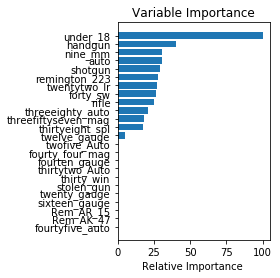

In [141]:

# fit model no training data
model = XGBClassifier(eta=0.3,
                      n_estimators=7000,
                      max_depth=8)
model.fit(X_res, y_res)
print('Score:', model.score(X_res, y_res))
scores = cross_val_score(model, X_res, y_res, cv=6)
print('Cross-validated scores:', scores)
# plot feature importance
#feat_importance = plot_importance(model)
feature_importance = model.feature_importances_
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X_res.columns[sorted_idx])
plt.xlabel('Relative Importance ')
plt.title('Variable Importance')
plt.show()

#### Linear SVM

In [142]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import cross_val_predict
clf = LinearSVC(random_state=0, tol=1e-5)
scores = cross_val_score(clf, X_res, y_res, cv=10)
cvpred = cross_val_predict(clf, X_res, y_res, cv=10)
print('Cross-validation Accuracy:', scores)
clf.fit(X_res, y_res)
y_pred = clf.predict(X_res)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_res, predictions)
print("Training Accuracy: %.2f%%" % (accuracy * 100.0))
print(pd.crosstab(cvpred, y_res))

Cross-validation Accuracy: [0.66666667 0.63636364 0.57070707 0.6010101  0.61616162 0.55612245
 0.61734694 0.61734694 0.60714286 0.62755102]
Training Accuracy: 61.62%
mass_shooting    0    1
row_0                  
0              836  616
1              149  369


#### Random Forest Classifer

Score: 0.617258883248731
Cross-validated scores: [0.65757576 0.59756098 0.61280488 0.57926829 0.60060976 0.63414634]
Accuracy: 61.73%


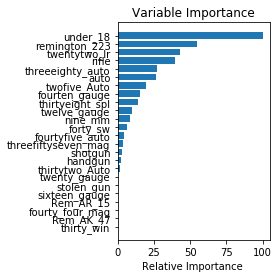

mass_shooting    0    1
row_0                  
0              853  630
1              132  355


In [145]:
#X_res, y_res = make_classification(n_samples=5000, n_features=24,
                           #n_informative=2, n_redundant=0,
                           #random_state=0, shuffle=False)
clf = RandomForestClassifier(n_estimators=100, max_depth=2,
                             random_state=0)
clf.fit(X_res, y_res)
predictions = clf.predict(X_res)
print('Score:', clf.score(X_res, y_res))
scores = cross_val_score(clf, X_res, y_res, cv=6)
print('Cross-validated scores:', scores)
y_pred = clf.predict(X_res)
predictions = [round(value) for value in y_pred]
accuracy = accuracy_score(y_res, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))
# plot feature importance
#feat_importance = plot_importance(model)
feature_importance = clf.feature_importances_
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X_res.columns[sorted_idx])
plt.xlabel('Relative Importance ')
plt.title('Variable Importance')
plt.show()
cvpred = cross_val_predict(clf, X_res, y_res, cv=10)
print(pd.crosstab(cvpred, y_res))

### Gradient boost ultimately outperformed the other models.  However, the accuracy is still weak.  Potentially, what could be done here is allowing more of the data that I removed to avoid bias, back in so that it may train better. I did tune the models to the best scores, so one other available option to improve it is to feature engineer to check for interactions between the features available, which may strengthen it.